# OpenCV

OpenCV-Python is a library of Python bindings designed to solve computer vision problems.

OpenCV-Python makes use of Numpy, which is a highly optimized library for numerical operations with a MATLAB-style syntax. 

All the OpenCV array structures are converted to and from Numpy arrays. This also makes it easier to integrate with other libraries that use Numpy such as SciPy and Matplotlib.

In [27]:
import cv2 

# OpenCV - Basic Operations on an image

Reading Image, Extracting height & width, Extracting RGB values

In [1]:
# Reading Image
image = cv2.imread('AnalogClock.jpg') 
  
# Extracting the height and width of an image 
h, w = image.shape[:2] 
print("Height = {},  Width = {}".format(h, w)) 

Height = 745,  Width = 1125


In [28]:
# reading image in colab
from google.colab.patches import cv2_imshow
def show_image(image):
  cv2_imshow(image)                 
  cv2.waitKey(0)

In [ ]:
show_image(image)

In [7]:
# Extracting RGB values.  
(B, G, R) = image[100, 100] 
print("R = {}, G = {}, B = {}".format(R, G, B)) 

R = 53, G = 55, B = 54


In [8]:
# extract via channel
B = image[100, 100, 0] 
print("B = {}".format(B)) 

B = 54


In [9]:
# Extracting the Region of Interest (ROI) by slicing the pixels
roi = image[100 : 500, 200 : 700] 

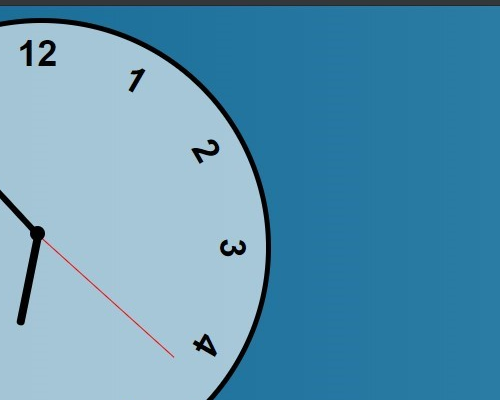

In [17]:
show_image(roi)

Resizing an image

In [21]:
# Image rezizing
# params are the image and the dimensions 
resize = cv2.resize(image, (200, 200)) 

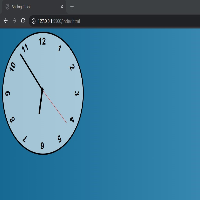

In [22]:
show_image(resize)

In [25]:
# Resizing by maintaining aspect ratio
ratio = 200 / w 
dim = (200, int(h * ratio)) 
resize_aspect = cv2.resize(image, dim) 

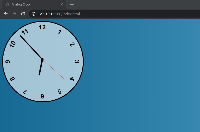

In [26]:
show_image(resize_aspect)

Rotating an Image

In [31]:
# Rotating Image
center = (w // 2, h // 2) 
rot_matrix = cv2.getRotationMatrix2D(center, -45, 1.0) 
rotated = cv2.warpAffine(image, rot_matrix, (w, h)) 

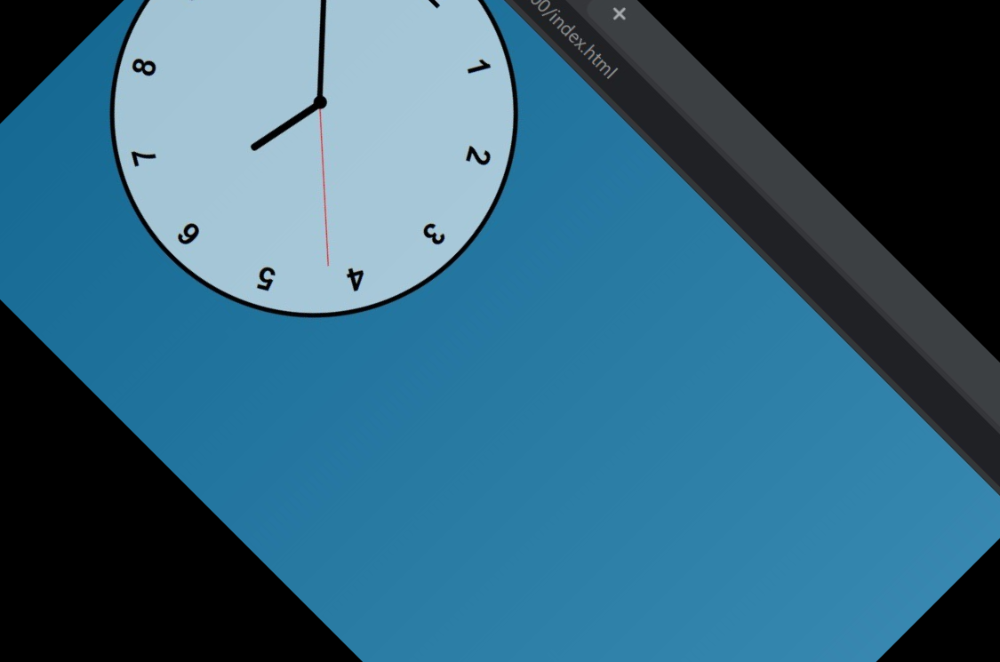

In [33]:
show_image(rotated)

Draw shape on image

In [38]:
# Draw rectangle on image
output = image.copy() 
rectangle = cv2.rectangle(output, (1500, 900),  
                          (600, 400), (200, 215, 0), 5)

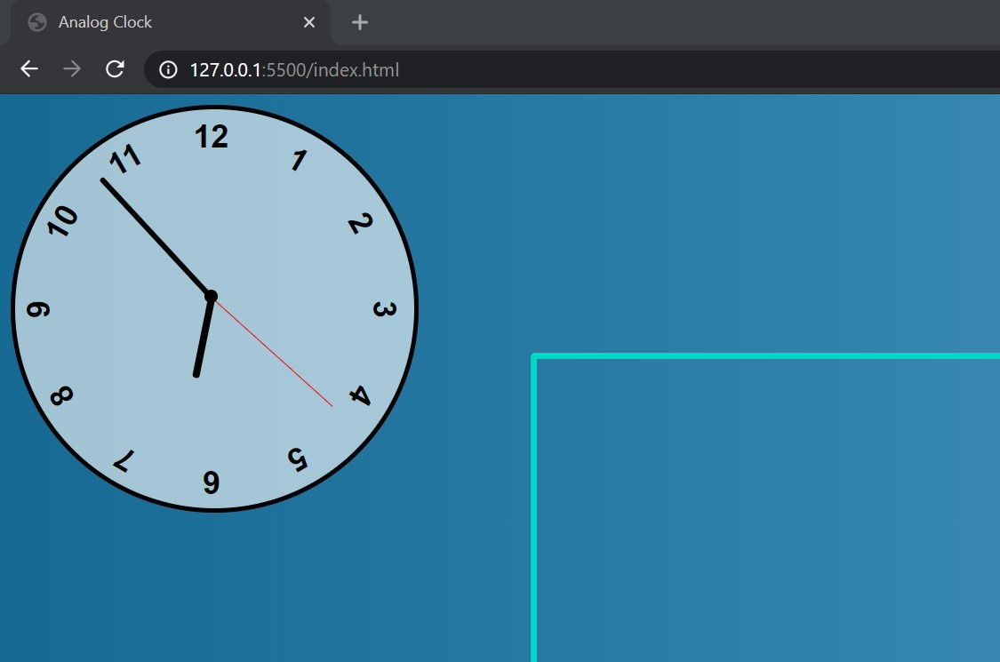

In [39]:
show_image(output)

Draw text on image

In [40]:
output1 = image.copy() 
text = cv2.putText(output1, 'CLOCK', (500, 550), cv2.FONT_HERSHEY_SIMPLEX, 4, (200, 150, 50), 2) 

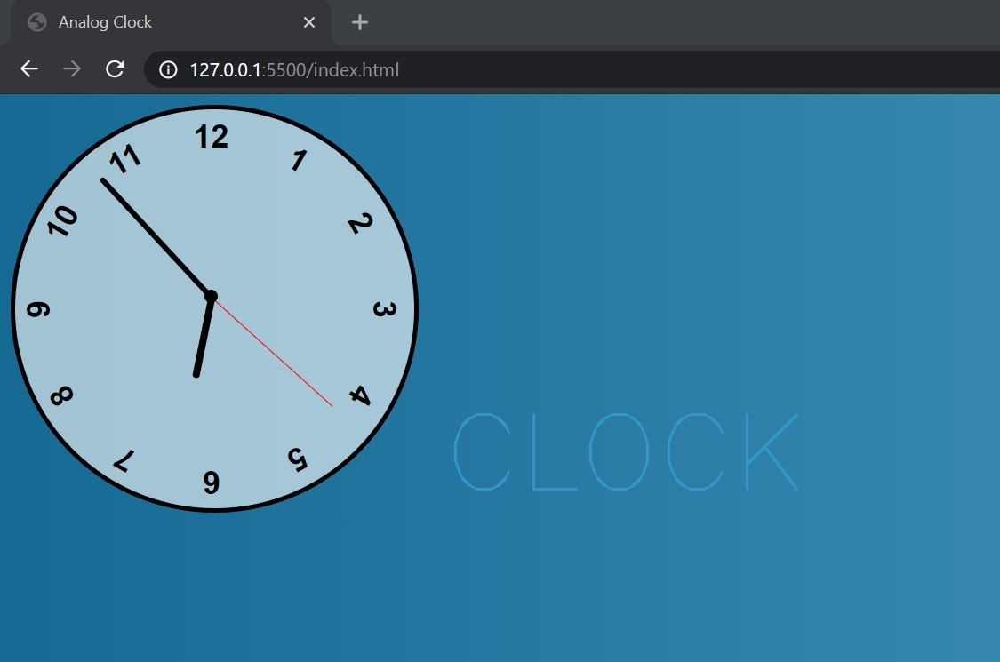

In [41]:
show_image(output1)

# OpenCV - Detect angle and rotate the image

In [47]:
import numpy as np
import math
from scipy import ndimage

In [49]:
img_before = cv2.imread('tilt-3.jpg') 

In [ ]:
imgGray = cv2.cvtColor(img_before, cv2.COLOR_BGR2GRAY)
show_image(imgGray)

In [ ]:
imgEdges = cv2.Canny(imgGray, 100, 100, apertureSize=3)
show_image(imgEdges)

In [ ]:
lines = cv2.HoughLinesP(imgEdges, 1, math.pi / 180.0, 100, minLineLength=100, maxLineGap=5)
angles = []


for [[x1, y1, x2, y2]] in lines:
    cv2.line(img_before, (x1, y1), (x2, y2), (255, 0, 0), 3)
    angle = math.degrees(math.atan2(y2 - y1, x2 - x1))
    angles.append(angle)

show_image(img_before)

In [138]:
median_angle = np.median(angles)
print(median_angle)

23.396137814466066


In [ ]:
img_rotated = ndimage.rotate(img_before, median_angle)
show_image(img_rotated)

# OpenCV - Blurring an image

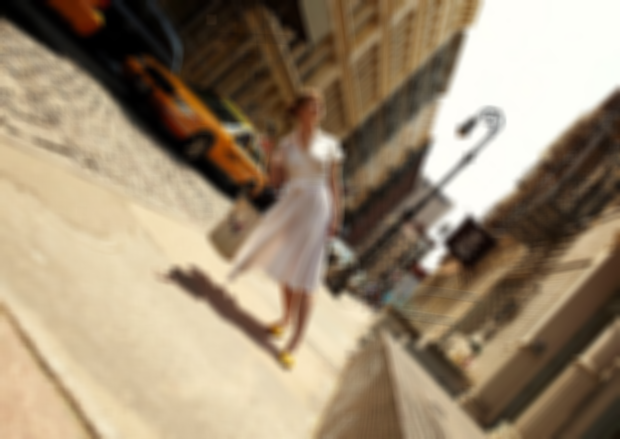

In [58]:
img = cv2.imread('tilt-3.jpg')  
blurImg = cv2.blur(img,(10,10))  
show_image(blurImg)

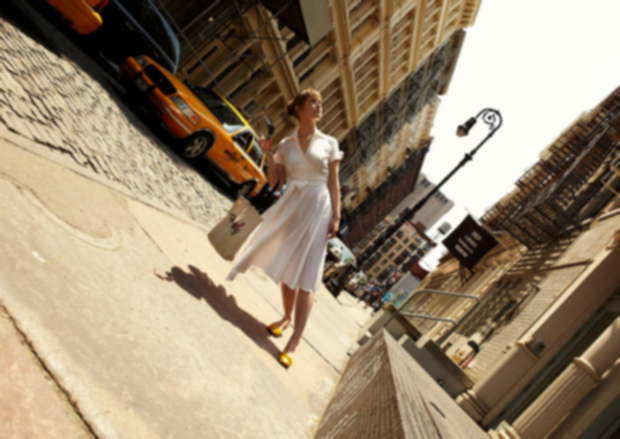

In [59]:
# Gaussian Blurring
gausBlur = cv2.GaussianBlur(img, (5,5),0)  
show_image(gausBlur)

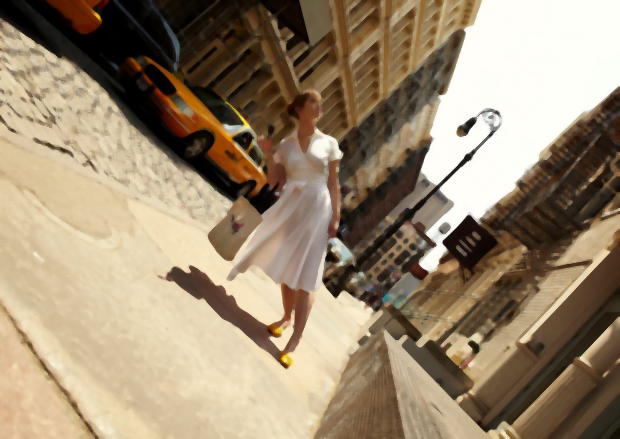

In [60]:
# Median blurring
medBlur = cv2.medianBlur(img,5) 
show_image(medBlur)

In [61]:
# Motion Blurring
img = cv2.imread('car.jpeg') 
kernel_size = 30 # more size = more motion
kernel_v = np.zeros((kernel_size, kernel_size)) 
kernel_h = np.copy(kernel_v) 


In [ ]:
# Fill the middle row with ones then normalize. 
kernel_v[:, int((kernel_size - 1)/2)] = np.ones(kernel_size) 
kernel_h[int((kernel_size - 1)/2), :] = np.ones(kernel_size) 
kernel_v /= kernel_size 
# print(kernel_v)
kernel_h /= kernel_size 
# print(kernel_h)

In [67]:
vertical_mb = cv2.filter2D(img, -1, kernel_v) 
horizonal_mb = cv2.filter2D(img, -1, kernel_h) 

In [ ]:
show_image(vertical_mb)

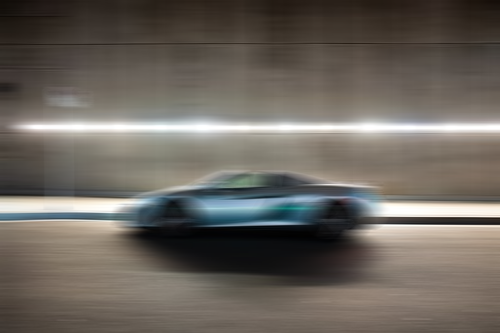

In [65]:
show_image(horizonal_mb)

# OpenCV - Cartoonizing an image

In [ ]:
img = cv2.imread("dog.jpg") 
show_image(img)

In [72]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
gray = cv2.medianBlur(gray, 5) 
edges = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9) 
# print(edges)

In [ ]:
show_image(edges)

In [ ]:
color = cv2.bilateralFilter(img, 9, 250, 250) 
show_image(color)

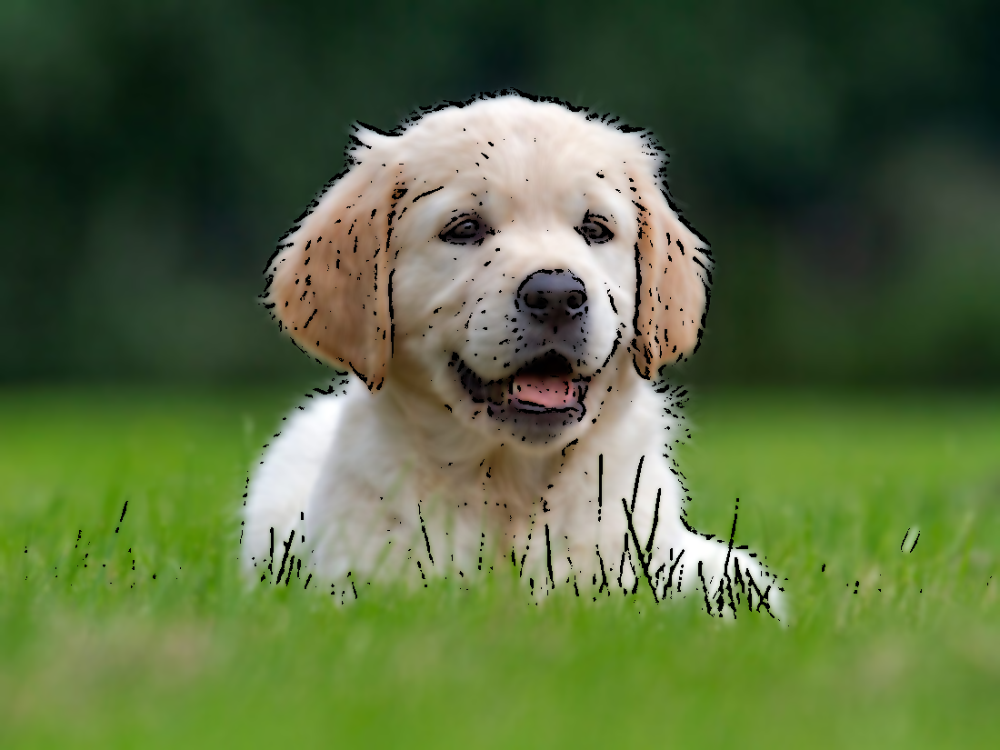

In [75]:
cartoon = cv2.bitwise_and(color, color, mask=edges) 
show_image(cartoon)

# OpenCV - Image Registration

Ref: https://www.learnopencv.com/image-alignment-feature-based-using-opencv-c-python/

Image registration is a digital image processing technique which helps us align different images of the same scene. 

For instance, one may click the picture of a book from various angles.

Now, we may want to “align” a particular image to the same angle as a reference image. 

 The image registration algorithm helps us align the second and third pictures to the same plane as the first one.

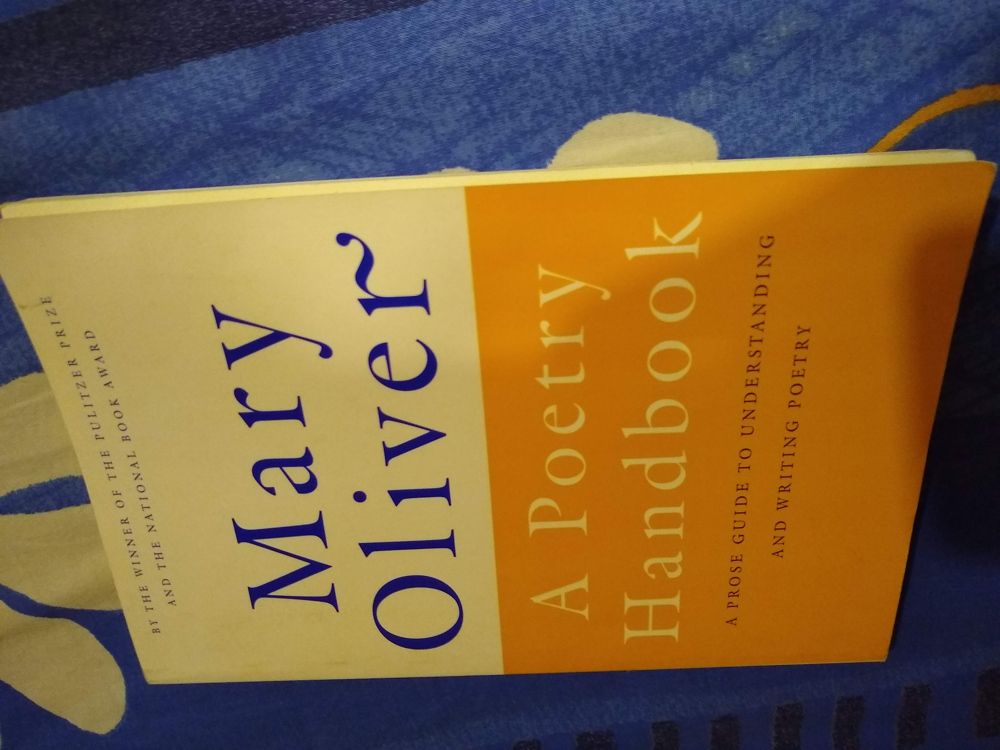

In [98]:
img_1 = cv2.imread("nonaligned.jpg")
show_image(img_1)

In [ ]:
img_2 = cv2.imread("ref.jpg")  
show_image(img_2)

In [100]:
# Convert both images to grayscale.
img1 = cv2.cvtColor(img_1, cv2.COLOR_BGR2GRAY) 
img2 = cv2.cvtColor(img_2, cv2.COLOR_BGR2GRAY) 

ORB (Oriented FAST and Rotated BRIEF) implementation in the OpenCV library, which provides us with both keypoints as well as their associated descriptors.

Keypoints are simply the selected few points which are used to compute the transform (generally points that stand out), and descriptors are histograms of the image gradients to characterize the appearance of a keypoint.

In [84]:
# Create ORB detector with 5000 features. 
orb_detector = cv2.ORB_create(5000) 
# Find keypoints and descriptors. 
kp1, d1 = orb_detector.detectAndCompute(img1, None) 
# print(type(kp1))
kp2, d2 = orb_detector.detectAndCompute(img2, None) 

<class 'list'>


In [86]:
 # BFMatcher.match() retrieves the best match
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)
matches = matcher.match(d1, d2) 
print(type(matches))

<class 'list'>


In [87]:
matches.sort(key = lambda x: x.distance) # sorting matches

In [89]:
matches = matches[:int(len(matches)*90)]  # take top 90 % matches only
no_of_matches = len(matches) 
print(no_of_matches)

1364


In [90]:
p1 = np.zeros((no_of_matches, 2)) 
p2 = np.zeros((no_of_matches, 2)) 

In [91]:
for i in range(len(matches)): 
  p1[i, :] = kp1[matches[i].queryIdx].pt 
  p2[i, :] = kp2[matches[i].trainIdx].pt 

findHomography method utilizes a robust estimation technique called Random Sample Consensus (RANSAC) which produces the right result even in the presence of large number of bad matches.

Find RANSAC implementation from scratch at : https://github.com/dikshakewat3776/Stitching-Images-using-OpenCV-and-RANSAC-algorithhm

In [93]:
homography, mask = cv2.findHomography(p1, p2, cv2.RANSAC) 

In [95]:
height, width = img2.shape

In [101]:
transformed = cv2.warpPerspective(img_1, homography, (width, height)) 

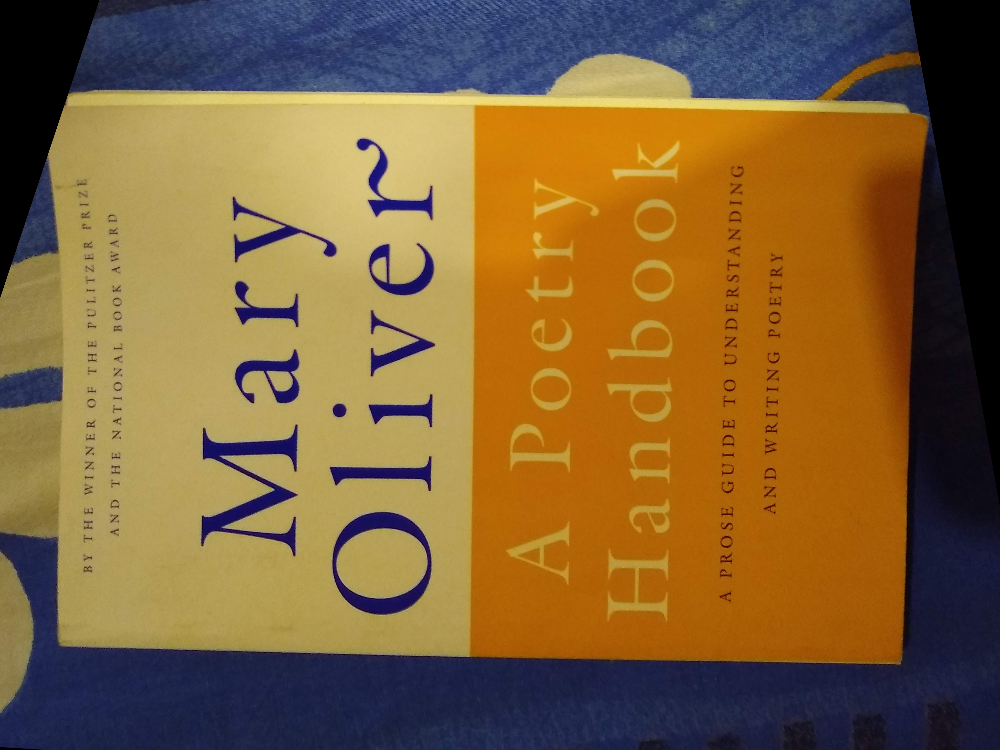

In [102]:
show_image(transformed)

# OpenCV - Image pyramiding

Advantages of Image pyramids:

Lowering of resolution

Getting various sizes of image

Image Blending

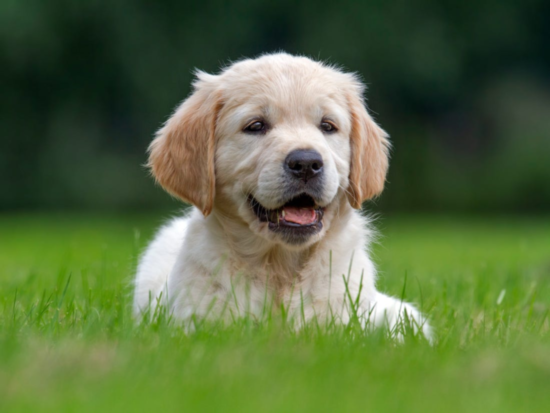

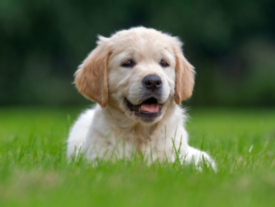

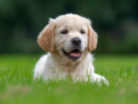

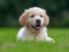

In [105]:
layer = img.copy() 
for i in range(4): 
    layer = cv2.pyrDown(layer) 
    show_image(layer)

# OpenCV - Corner Detection

In [127]:
img_c = cv2.imread("dog.jpg")  

In [128]:
gray = cv2.cvtColor(img_c, cv2.COLOR_BGR2GRAY) 

In [129]:
# detect corners with the goodFeaturesToTrack function. 
corners = cv2.goodFeaturesToTrack(gray, 27, 0.01, 10) 
corners = np.int0(corners) 

In [136]:
for i in corners: 
    x, y = i.ravel() 
    cv2.circle(img_c, (x, y), 5, (0, 0, 255), -1) 

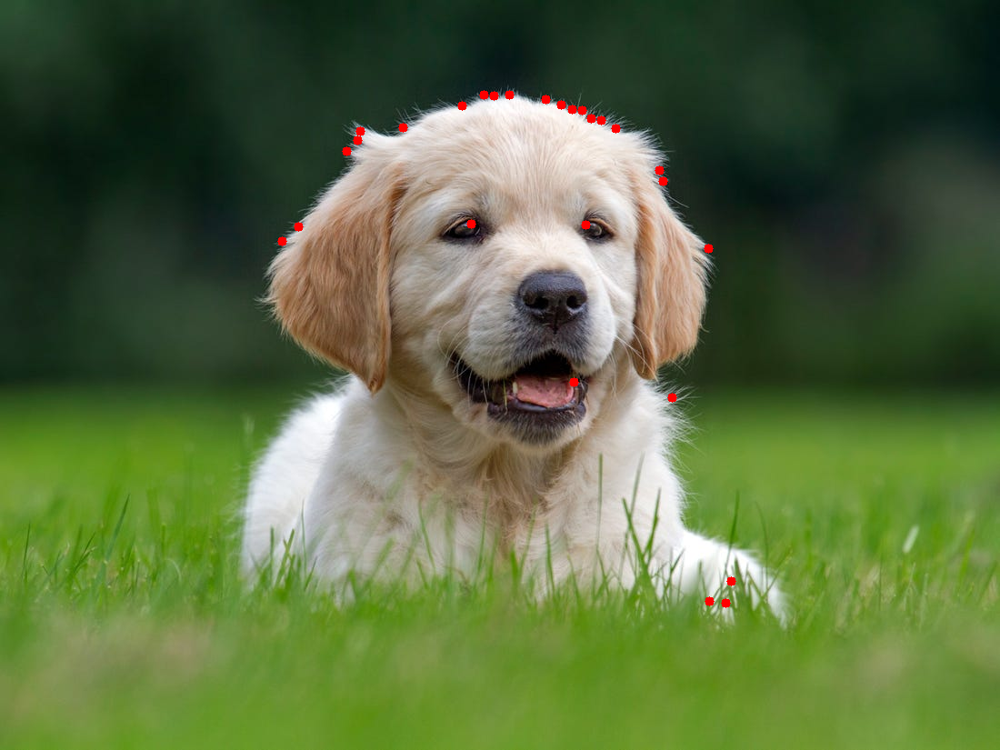

In [137]:
show_image(img_c)